In [2]:
using DifferentialEquations
using Plots
using Kronecker
using LinearAlgebra

In [4]:
A = [
  -1.4968  1.0555  0.     -0.3412  0.    
  0.     -0.7477 -0.1997  0.      0.448 
  0.      1.267  -3.436   0.4342 -1.6348
  0.      0.      0.     -1.      0.    
  0.      0.     -0.2596 -0.2082 -0.5678
]
n = 5

function hurtzian(u,p,t)
  return A*u
  # du[1] = -5.0*u[1]+u[2]
  # du[2] = -1.0*u[2]
  # du[3] = -2.0*u[3]+u[2]
end
  
function σ_hurtzian(u,p,t)
  return ones(n)
end
  
prob_sde = SDEProblem(hurtzian,σ_hurtzian,zeros(n),(0.0,100000.0))
sol = solve(prob_sde, EM(), dt=0.001, saveat=1.0)
1

1

In [85]:
plot(sol,vars=(1,3),seriestype = :scatter, markersize = .1, aspect_ratio = 1)

In [1]:
A = [
  -1.  1.  
  0.     -3.
]
n = 2

function hurwitz(u,p,t)
  return A*u
  # du[1] = -5.0*u[1]+u[2]
  # du[2] = -1.0*u[2]
  # du[3] = -2.0*u[3]+u[2]
end
  
function σ_hurwitz(u,p,t)
  return ones(n)
end
  
prob_sde = SDEProblem(hurwitz,σ_hurwitz,zeros(n),(0.0,100000.0))
sol = solve(prob_sde, LambaEM(), saveat=1., maxiters = 1e7)

LoadError: UndefVarError: SDEProblem not defined

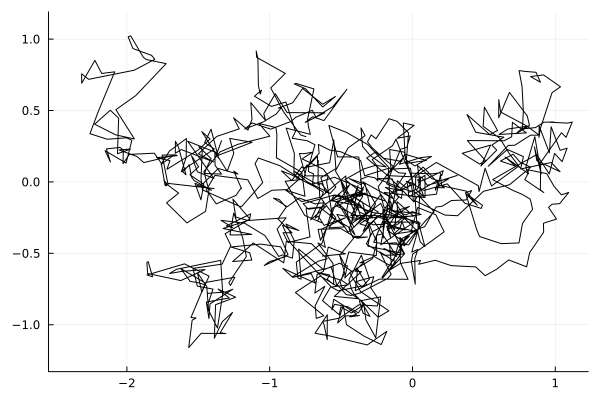

In [51]:
plot(sol,vars=(1,2),aspect_ratio = 1, legend=false, color="black")

In [59]:
plot(sol,vars=(1,2),seriestype = :scatter, color="black", markersize = .5, aspect_ratio = 1, legend = false)

In [13]:
A = [
  -1.  0.  
  1.  -2.
]

2×2 Matrix{Float64}:
 -1.0   0.0
  1.0  -2.0

In [12]:
anaGam = -reshape(inv(kronecker(A, Matrix(1.0I, n, n)) + kronecker(Matrix(1.0I, n, n), A))*vec(Matrix(1.0I, n, n)), (n,n))

2×2 Matrix{Float64}:
 0.583333   0.0833333
 0.0833333  0.25

In [14]:
anaGam = -reshape(inv(kronecker(A, Matrix(1.0I, n, n)) + kronecker(Matrix(1.0I, n, n), A))*vec(Matrix(1.0I, n, n)), (n,n))

2×2 Matrix{Float64}:
 0.5       0.166667
 0.166667  0.333333

In [61]:
dtM = mapreduce(permutedims, vcat, sol.u)
gamma = (transpose(dtM)*dtM)/length(dtM[:,1])

2×2 Matrix{Float64}:
 0.545208   0.0408378
 0.0408378  0.173649

In [30]:
est = Kraskov(k = 4)
for s in [1,2,3]
    for d in [1,2,3]
        if s == d
            continue
        end
        (s+d == 3) ? c = 3 : ((s+d == 4) ? c = 2 : c = 1)
        source = [sol.u[i][s] for i in 1:length(sol.u)]
        dest = [sol.u[i][d] for i in 1:length(sol.u)]
        cond = [sol.u[i][c] for i in 1:length(sol.u)]
        print("Transfer from ", s, " to ", d, " cond ", c,": ")
        println(transferentropy(source, dest, cond, est))
    end
end

Transfer from 1 to 2 cond 3: 0.01693803208823219
Transfer from 1 to 3 cond 2: 0.012931236664638135
Transfer from 2 to 1 cond 3: 0.03218758726394633
Transfer from 2 to 3 cond 1: 0.054553323231770534
Transfer from 3 to 1 cond 2: 0.007367926497611421
Transfer from 3 to 2 cond 1: 0.011337950353903281


## Ornstein-Uhlenbeck Process

In [73]:
λ = 0.5
q = 1.0

function OUf(u,p,t)
    return -λ*u
end

function σ_OU(u,p,t)
    return q
end
plot()
varval = 0.
reps = 100
prob_sde = SDEProblem(OUf,σ_OU,1.0,(0.0,10.0))
for _ in 1:(reps-1)
    sol = solve(prob_sde, EM(), dt=0.01, saveat=0.01)
    plot!(sol)
    varval += (last(sol.u) - ℯ^(-0.5*last(sol.t)))^2
end
varval/reps

0.9276134323669694

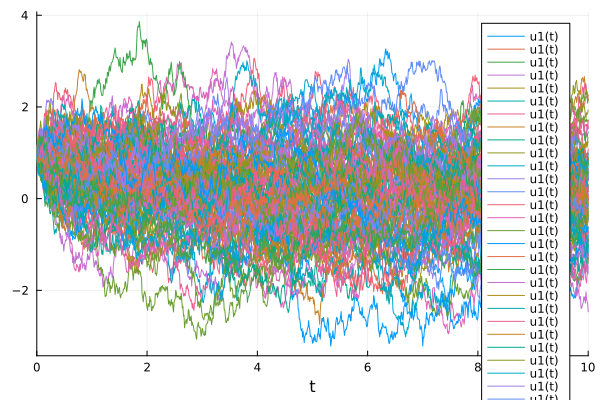

In [74]:
plot!()

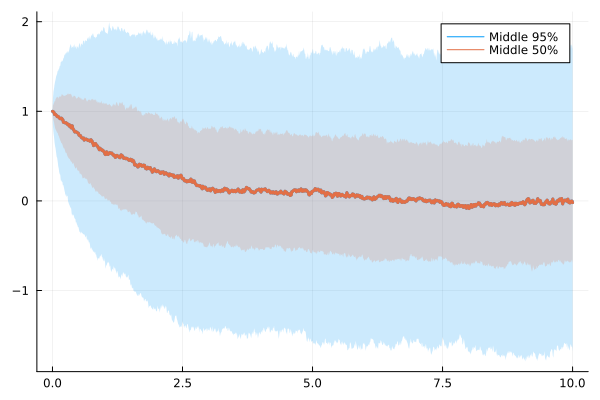

In [75]:
ensembleprob = EnsembleProblem(prob_sde)
sol = solve(ensembleprob,EnsembleThreads(),trajectories=1000)
using DifferentialEquations.EnsembleAnalysis
summ = EnsembleSummary(sol,0:0.01:10)
plot(summ,labels="Middle 95%")
summ = EnsembleSummary(sol,0:0.01:10;quantiles=[0.25,0.75])
plot!(summ,labels="Middle 50%",legend=true)

### Black-Scholes

In [79]:
μ = 1/10
σ = 1.0

function BSf(u,p,t)
    return μ*u
end

function σ_BS(u,p,t)
    return σ*u
end
plot()
varval = 0.
reps = 100
prob_sde = SDEProblem(BSf,σ_BS,1.0,(0.0,10.0))
for _ in 1:(reps-1)
    sol = solve(prob_sde, EM(), dt=0.001, saveat=0.01)
    plot!(sol)
    varval += (last(sol.u) - ℯ^(-0.5*last(sol.t)))^2
end
varval/reps

200.8695030115265

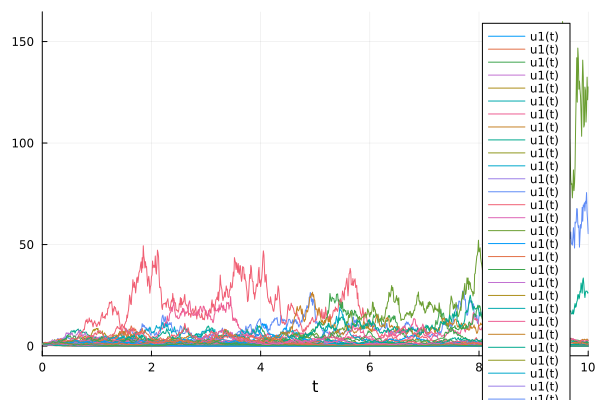

In [80]:
plot!()

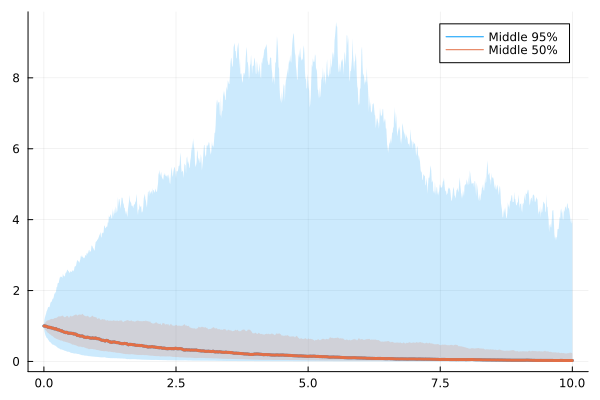

In [81]:
ensembleprob = EnsembleProblem(prob_sde)
sol = solve(ensembleprob,EnsembleThreads(),trajectories=1000)
using DifferentialEquations.EnsembleAnalysis
summ = EnsembleSummary(sol,0:0.01:10)
plot(summ,labels="Middle 95%")
summ = EnsembleSummary(sol,0:0.01:10;quantiles=[0.25,0.75])
plot!(summ,labels="Middle 50%",legend=true)